In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import os
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp



In [2]:
# Load all the provided CSV files
nyon_2023 = pd.read_csv('./data/combined_data_v1/nyon_2023.csv')
nyon_2022 = pd.read_csv('./data/combined_data_v1/nyon_2022.csv')
rolle_2022 = pd.read_csv('./data/combined_data_v1/rolle_2022.csv')
rolle_2023 = pd.read_csv('./data/combined_data_v1/rolle_2023.csv')
vevey_2022 = pd.read_csv('./data/combined_data_v1/vevey_2022.csv')
vevey_2023 = pd.read_csv('./data/combined_data_v1/vevey_2023.csv')

# Add a municipality column to each dataframe
nyon_2022['city'] = 'Nyon'
nyon_2023['city'] = 'Nyon'
rolle_2022['city'] = 'Rolle'
rolle_2023['city'] = 'Rolle'
vevey_2022['city'] = 'Vevey'
vevey_2023['city'] = 'Vevey'

# Add a year column to each dataframe
nyon_2022['year'] = 2022
nyon_2023['year'] = 2023
rolle_2022['year'] = 2022
rolle_2023['year'] = 2023
vevey_2022['year'] = 2022
vevey_2023['year'] = 2023

In [3]:
nyon_2022

,text,esg_predictor,sentiment_pred,source,date,city,year
0,1. \n\nAppel : \n\n80 Conseillères et Conseil...,non-esg,4.000,2201,2022-01-01,Nyon,2022
1,"les Municipaux Claude ULDRY, \nAlexandre DÉMÉT...",gouvernance,4.000,2201,2022-01-01,Nyon,2022
2,Elle ouvre cette \ncinquième séance du Cons...,non-esg,3.667,2201,2022-01-01,Nyon,2022
3,Le Bureau a étudié les conditions de mi...,non-esg,4.000,2201,2022-01-01,Nyon,2022
4,"Dans ce cadre, une séance du Bureau du Conseil...",non-esg,4.667,2201,2022-01-01,Nyon,2022
...,...,...,...,...,...,...,...
2048,Notre gratitude et nos félicitations à \n...,gouvernance,5.000,2212,2022-12-01,Nyon,2022
2049,VISION POUR L’AVENIR \n\nLes turbulences vécu...,environnemental,3.667,2212,2022-12-01,Nyon,2022
2050,A propos de la situation financière de notre C...,gouvernance,4.667,2212,2022-12-01,Nyon,2022
2051,"Avec le soutien du Conseil communal, le dévelo...",non-esg,3.667,2212,2022-12-01,Nyon,2022


# Box plot category wise

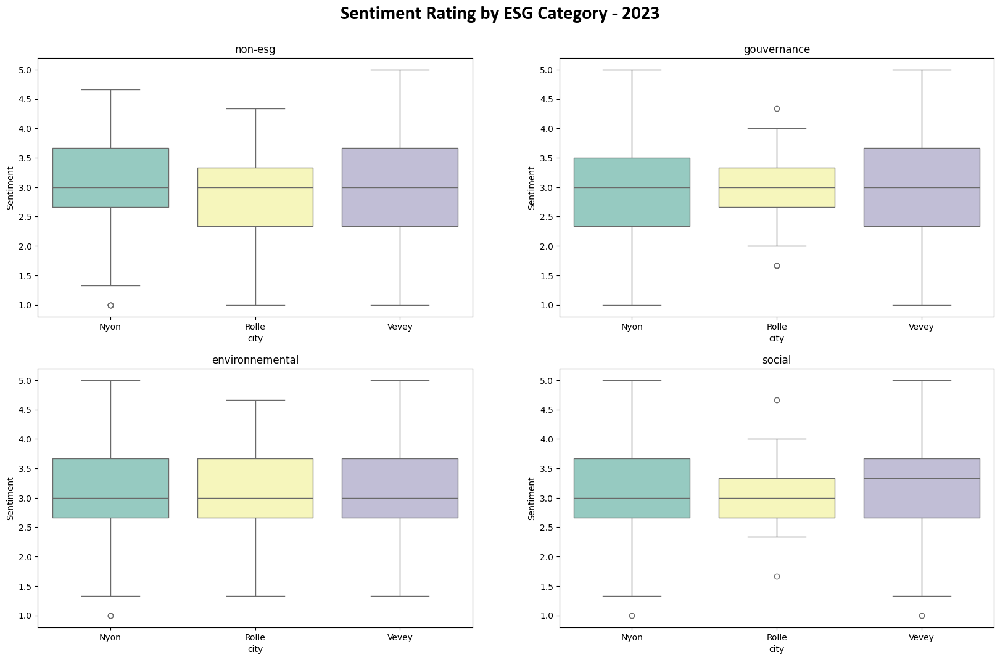

In [33]:

df = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)



def plot_data(df_nyon, df_rolle, df_vevey,  x_label ="city",  title = " "):
    
    df = pd.concat([df_nyon, df_rolle, df_vevey], ignore_index=True)
    
    
    if x_label == "city":
        plt.figure(figsize=(20, 16))
        sns.boxplot(x='city', y='sentiment_pred', data=df, hue='city', palette='Set3')
        plt.ylabel('Sentiment')
        plt.title(title)
        plt.show()
        
    if x_label == "esg_category":
        # subfigure for unique values in esg_category(x4)
        fig, axes = plt.subplots(2, 2, figsize=(20, 12))
        axes = axes.flatten()
        for i, esg_category in enumerate(df.esg_predictor.unique()):
            sns.boxplot(x='city', y='sentiment_pred', data=df[df.esg_predictor == esg_category], ax=axes[i], hue='city', palette='Set3')
            axes[i].set_title(esg_category)
            axes[i].set_ylabel('Sentiment')
        
        # title
        plt.suptitle(title, fontsize=22, fontname = 'Calibri', fontweight = 'bold',x=0.5, y=0.95)
        plt.show()
    

plot_data(nyon_2023, rolle_2023, vevey_2023,  x_label="esg_category", title="Sentiment Rating by ESG Category - 2023")

# Plotly scatter+boxplot

In [23]:

combined_data = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)

# Convert the date column to datetime
combined_data['date'] = pd.to_datetime(combined_data['date'])

# Create a hover text column with truncated text
combined_data['hover_text'] = combined_data['text']
combined_data['hover_text'] = combined_data['hover_text'].apply(lambda x: '<br>'.join([x[i:i+100] for i in range(0, len(x), 100)])) #line break

# show only data where the esg_predictor is environnemental
# combined_data = combined_data[combined_data['esg_predictor'] == 'gouvernance']

# Add jitter to the sentiment_pred values
jitter_strength = 0.1  # Adjust this value to increase/decrease jitter
combined_data['sentiment_pred_jittered'] = combined_data['sentiment_pred'] + np.random.uniform(-jitter_strength, jitter_strength, combined_data.shape[0])

# Create the violin plot with jittered values
fig = px.violin(combined_data, x='city', y='sentiment_pred_jittered', color='city',
                hover_data=['hover_text'], title='<b>Distribution of Ratings Across Municipalities <br> with Scatter plot for interactive viewing</b>',
                points="all", violinmode='overlay', box=True)

# fig = px.box(combined_data, x='city', y='sentiment_pred', color='city', hover_data=['hover_text'], title='Sentiment Trend for All Cities')

fig.update_layout(autosize=False,
                  title = {'x': 0.5},
                  width=1200,
                  height=600)



# Save the plot to an HTML file
fig.write_html("./html/sentiment_trend_all_cities.html")
fig.write_image("./results/figures/sentiment_distribution.png")

# Show the plot
fig.show()


In [24]:
# histogram of number of rows per municipality
fig = px.histogram(combined_data, x='city', title='Number of Rows per Municipality')

fig.write_image("./results/figures/rows_per_municipality.png")

fig.show()

# Category wise

## line plot average - category wise

In [25]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Assuming the CSV files have been loaded and combined into combined_data
combined_data = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)

combined_data = combined_data[combined_data['esg_predictor'] == 'social']

nyon_data = combined_data[combined_data['city'] == 'Nyon']
rolle_data = combined_data[combined_data['city'] == 'Rolle']
vevey_data = combined_data[combined_data['city'] == 'Vevey']



# print length ocmbined data
print(combined_data.head())
print(len(combined_data))


# Convert the date column to datetime
combined_data['date'] = pd.to_datetime(combined_data['date'])

# Create a hover text column with truncated text
combined_data['hover_text'] = combined_data['text']
combined_data['hover_text'] = combined_data['hover_text'].apply(lambda x: '<br>'.join([x[i:i+100] for i in range(0, len(x), 100)])) #line break

# Show only data where the esg_predictor is governance
combined_data = combined_data[combined_data['esg_predictor'] == 'social']

# Create a column for the month-year for aggregation
combined_data['year_month'] = combined_data['date'].dt.to_period('M')

# Calculate the average sentiment per month
average_sentiment = combined_data.groupby('year_month')['sentiment_pred'].mean().reset_index()
average_sentiment['year_month'] = average_sentiment['year_month'].dt.to_timestamp()

# Create the scatter plot for individual texts
scatter = go.Scatter(
    x=combined_data['date'],
    y=combined_data['sentiment_pred'],
    mode='markers',
    marker=dict(color='blue'),
    text=combined_data['hover_text'],
    hoverinfo='text',
    name='Individual Ratings'
)

# Create the line plot for average sentiment trend
line = go.Scatter(
    x=average_sentiment['year_month'],
    y=average_sentiment['sentiment_pred'],
    mode='lines',
    line=dict(color='red'),
    name='Average Sentiment Trend'
)

# Combine the plots
fig = make_subplots()
fig.add_trace(scatter)
fig.add_trace(line)

# Update layout
fig.update_layout(
    title={
        'text': '<b>Individual Text Ratings and Average Sentiment Trend Over Time</b>',
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title='Date',
    yaxis_title='Sentiment Rating',
    autosize=False, 
    width=1200, 
    height=600
)

# Save the plot to an HTML file
fig.write_html("./html/sentiment_trend_all_cities.html")
fig.write_image("./results/figures/sentiment_trend_all_cities.png")

# Show the plot
fig.show()


                                                 text esg_predictor  \
22  Ils ne peuvent pas se faire \nsans engendrer d...        social   
24  Il semble important de \npréciser également qu...        social   
28  Il comprend bien qu’à la lecture des éléments ...        social   
29  Comme  la \nMunicipalité a déjà eu l’occasion ...        social   
30  La personnalité des \ncollaborateurs et collab...        social   

    sentiment_pred  source        date  city  year  
22           3.333    2201  2022-01-01  Nyon  2022  
24           3.333    2201  2022-01-01  Nyon  2022  
28           3.333    2201  2022-01-01  Nyon  2022  
29           3.000    2201  2022-01-01  Nyon  2022  
30           2.333    2201  2022-01-01  Nyon  2022  
621


## heatmap with interactive hover text

In [26]:
import pandas as pd
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots

# Assuming the CSV files have been loaded and combined into combined_data
combined_data = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)

# Convert the date column to datetime
combined_data['date'] = pd.to_datetime(combined_data['date'])

# Create a hover text column with truncated text
combined_data['hover_text'] = combined_data['text']
combined_data['hover_text'] = combined_data['hover_text'].apply(lambda x: '<br>'.join([x[i:i+100] for i in range(0, len(x), 100)])) #line break

# Show only data where the esg_predictor is governance
combined_data = combined_data[combined_data['esg_predictor'] == 'gouvernance']

# Create a column for the month-year for aggregation
combined_data['year_month'] = combined_data['date'].dt.to_period('M')

# Calculate the average sentiment per month
average_sentiment = combined_data.groupby('year_month')['sentiment_pred'].mean().reset_index()
average_sentiment['year_month'] = average_sentiment['year_month'].dt.to_timestamp()

# Create the density heatmap for sentiment ratings
heatmap = px.density_heatmap(
    combined_data,
    x='date',
    y='sentiment_pred',
    nbinsx=30,  # Adjust number of bins as needed
    nbinsy=20,  # Adjust number of bins as needed
    title='Density Heatmap of Text Ratings and Average Sentiment Trend Over Time',
    labels={'date': 'Date', 'sentiment_pred': 'Sentiment Rating'}
)

# Create the scatter plot for individual text ratings with hover text
scatter = go.Scattergl(
    x=combined_data['date'],
    y=combined_data['sentiment_pred'],
    mode='markers',
    marker=dict(color='rgba(0, 0, 0, 0)', size=3),  # Transparent markers
    text=combined_data['hover_text'],
    hoverinfo='text',
    name='Individual Ratings'
)

# Create the line plot for average sentiment trend
line = go.Scatter(
    x=average_sentiment['year_month'],
    y=average_sentiment['sentiment_pred'],
    mode='lines',
    line=dict(color='red'),
    name='Average Sentiment Trend'
)

# Add the scatter and line plots to the heatmap
heatmap.add_trace(scatter)
heatmap.add_trace(line)

# Update layout
heatmap.update_layout(
    title={
        'text': '<b>Density Heatmap of Text Ratings and Average Sentiment Trend Over Time</b>',
        'y': 0.9,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    autosize=False,
    width=1200,
    height=600
)

# Save the plot to an HTML file
heatmap.write_html("./html/sentiment_trend_all_cities.html")
heatmap.write_image("./results/figures/sentiment_trend_all_cities.png")

# Show the plot
heatmap.show()


In [27]:
# rolle_2022 count of esg_category
rolle_2022['esg_predictor'].value_counts()


esg_predictor
non-esg            128
environnemental    120
gouvernance         55
social               5
Name: count, dtype: int64

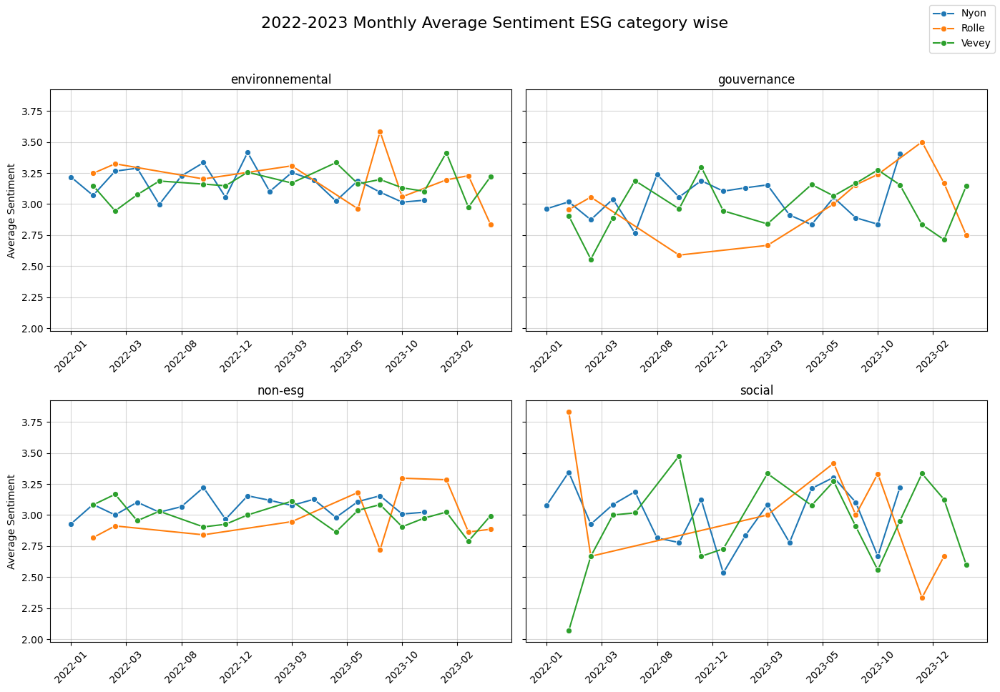

In [28]:
combined_df = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)


# Calculate the average sentiment for each ESG predictor by city and month-year
combined_df['month_year'] = pd.to_datetime(combined_df['date']).dt.to_period('M')
average_sentiment_monthly = combined_df.groupby(['esg_predictor', 'city', 'month_year'])['sentiment_pred'].mean().reset_index()

# Convert month_year to string for better plotting
average_sentiment_monthly['month_year'] = average_sentiment_monthly['month_year'].astype(str)

# Create subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharey=True)

# Flatten the axes array for easy iteration
axes = axes.flatten()

esg_predictors = average_sentiment_monthly['esg_predictor'].unique()

# Plot each ESG predictor
for i, esg_predictor in enumerate(esg_predictors):
    ax = axes[i]
    df = average_sentiment_monthly[average_sentiment_monthly['esg_predictor'] == esg_predictor]
    sns.lineplot(data=df, x='month_year', y='sentiment_pred', hue='city', marker='o', ax=ax)
    ax.set_title(esg_predictor)
    ax.set_ylabel('Average Sentiment')
    ax.set_xlabel('Month-Year')
    ax.tick_params(axis='x', rotation=45)
    # legnd off
    ax.get_legend().remove()
    ax.grid(True,alpha=0.5)
    
    # xaxis change the freuqnecy of the ticks
    ax.xaxis.set_major_locator(plt.MaxNLocator(10))
    # turn x label off
    ax.set_xlabel('')

# Set the main title
plt.suptitle('2022-2023 Monthly Average Sentiment ESG category wise ', fontsize=16)

handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Show plot
plt.show()


In [30]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go


# Combine all dataframes into one
combined_data = pd.concat([nyon_2022, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)

# Convert the date column to datetime
combined_data['date'] = pd.to_datetime(combined_data['date'])

# Create a hover text column with truncated text
combined_data['hover_text'] = combined_data['text']

# Go to the next line every 100 characters in the hover text
combined_data['hover_text'] = combined_data['hover_text'].apply(lambda x: '<br>'.join([x[i:i+100] for i in range(0, len(x), 100)]))

# jitter
jitter_strength = 0.1  
combined_data['sentiment_pred_jittered'] = combined_data['sentiment_pred'] + np.random.uniform(-jitter_strength, jitter_strength, combined_data.shape[0])

# Define colors for each ESG category
# Define colors for each ESG category (matte light colors)
# Define colors for each ESG category (darker colors)
category_colors = {
    'gouvernance': '#1f77b4',  # Dark Blue
    'social': '#2ca02c',       # Dark Green
    'environnemental': '#d62728',  # Dark Red
    'non-esg': '#9467bd'       # Dark Purple
}

# Define colors for each year (darker colors)
year_colors = {
    2022: '#ff7f0e',  # Dark Orange
    2023: '#e377c2'   # Dark Pink
}



# Function to create a box plot
# Function to create a box plot with black outlines
def create_box_plot(data):
    fig = go.Figure()
    for city in data['city'].unique():
        filtered_data = data[data['city'] == city]
        fig.add_trace(go.Box(
            y=filtered_data['sentiment_pred_jittered'],
            x=filtered_data['city'],
            name=city,
            marker_color=category_colors[filtered_data['esg_predictor'].iloc[0]],
            boxpoints='all',  # shows all points
            hovertext=filtered_data['hover_text'],
            marker=dict(
                line=dict(
                    color='black',  # outline color
                    width=1  # outline width
                )
            )
        ))
    return fig


# Initial plot with 'gouvernance' label
fig = create_box_plot(combined_data[combined_data['esg_predictor'] == 'gouvernance'])

# Add dropdown buttons to filter by ESG category
dropdown_buttons = [
    dict(
        args=[{
            "x": [combined_data[combined_data['esg_predictor'] == label]['city']],
            "y": [combined_data[combined_data['esg_predictor'] == label]['sentiment_pred_jittered']],
            "hovertext": [combined_data[combined_data['esg_predictor'] == label]['hover_text']],
            "marker.color": [category_colors[label] for _ in range(len(combined_data[combined_data['esg_predictor'] == label]))]
        }, {"title": f"Sentiment Trend for {label}"}],
        label=label,
        method="update"
    )
    for label in combined_data['esg_predictor'].unique()
]

# Add dropdown buttons to filter by year
year_buttons = [
    dict(
        args=[{
            "x": [combined_data[combined_data['year'] == year]['city']],
            "y": [combined_data[combined_data['year'] == year]['sentiment_pred_jittered']],
            "hovertext": [combined_data[combined_data['year'] == year]['hover_text']],
            "marker.color": [year_colors[year] for _ in range(len(combined_data[combined_data['year'] == year]))]
        }, {"title": f"Sentiment Trend for Year {year}"}],
        label=str(year),
        method="update"
    )
    for year in combined_data['year'].unique()
]


# Update layout to include both dropdown menus
fig.update_layout(
    updatemenus=[
        dict(
            buttons=dropdown_buttons,
            direction="down",
            showactive=True,
            x=0.15,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
        dict(
            buttons=year_buttons,
            direction="down",
            showactive=True,
            x=0.05,
            xanchor="left",
            y=1.1,
            yanchor="top"
        )
    ],
    title="Sentiment Trend for gouvernance in 2022",
    autosize=False,
    width=1200,
    height=600,
    title_x = 0.5
)


# Show the plot
fig.show()


In [31]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# Combine all dataframes into one and add the necessary columns
combined_data = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)

# Convert the date column to datetime
combined_data['date'] = pd.to_datetime(combined_data['date'])

# Create a hover text column with truncated text
combined_data['hover_text'] = combined_data['text']

# Go to the next line every 100 characters in the hover text
combined_data['hover_text'] = combined_data['hover_text'].apply(lambda x: '<br>'.join([x[i:i+100] for i in range(0, len(x), 100)]))

# jitter
jitter_strength = 0.1
combined_data['sentiment_pred_jittered'] = combined_data['sentiment_pred'] + np.random.uniform(-jitter_strength, jitter_strength, combined_data.shape[0])

# Define colors for each ESG category
category_colors = {
    'gouvernance': '#1f77b4',  # Dark Blue
    'social': '#2ca02c',       # Dark Green
    'environnemental': '#d62728',  # Dark Red
    'non-esg': '#9467bd'       # Dark Purple
}

# Define colors for each year
year_colors = {
    2022: '#ff7f0e',  # Dark Orange
    2023: '#e377c2'   # Dark Pink
}

# Define colors for each month
month_colors = {
    '2022-01': '#1f77b4', '2022-02': '#ff7f0e', '2022-03': '#2ca02c', '2022-04': '#d62728',
    '2022-05': '#9467bd', '2022-06': '#8c564b', '2022-07': '#e377c2', '2022-08': '#7f7f7f',
    '2022-09': '#bcbd22', '2022-10': '#17becf', '2022-11': '#1f77b4', '2022-12': '#ff7f0e',
    '2023-01': '#2ca02c', '2023-02': '#d62728', '2023-03': '#9467bd', '2023-04': '#8c564b',
    '2023-05': '#e377c2', '2023-06': '#7f7f7f', '2023-07': '#bcbd22', '2023-08': '#17becf',
    '2023-09': '#1f77b4', '2023-10': '#ff7f0e', '2023-11': '#2ca02c', '2023-12': '#d62728'
}

# Function to create a box plot
def create_box_plot(data):
    fig = go.Figure()
    for city in data['city'].unique():
        filtered_data = data[data['city'] == city]
        fig.add_trace(go.Box(
            y=filtered_data['sentiment_pred_jittered'],
            x=filtered_data['city'],
            name=city,
            marker_color=category_colors[filtered_data['esg_predictor'].iloc[0]],
            boxpoints='all',  # shows all points
            hovertext=filtered_data['hover_text'],
            marker=dict(
                line=dict(
                    color='black',  # outline color
                    width=1  # outline width
                )
            )
        ))
    return fig

# initial plot with 2022 data
fig = create_box_plot(combined_data[combined_data['year'] == 2022])

# Add dropdown buttons to filter by ESG category
dropdown_buttons = [
    dict(
        args=[{
            "x": [combined_data[combined_data['esg_predictor'] == label]['city']],
            "y": [combined_data[combined_data['esg_predictor'] == label]['sentiment_pred_jittered']],
            "hovertext": [combined_data[combined_data['esg_predictor'] == label]['hover_text']],
            "marker.color": [category_colors[label] for _ in range(len(combined_data[combined_data['esg_predictor'] == label]))]
        }, {"title": f"Sentiment Trend for {label}"}],
        label=label,
        method="update"
    )
    for label in combined_data['esg_predictor'].unique()
]

# Add dropdown buttons to filter by year
year_buttons = [
    dict(
        args=[{
            "x": [combined_data[combined_data['year'] == year]['city']],
            "y": [combined_data[combined_data['year'] == year]['sentiment_pred_jittered']],
            "hovertext": [combined_data[combined_data['year'] == year]['hover_text']],
            "marker.color": [year_colors[year] for _ in range(len(combined_data[combined_data['year'] == year]))]
        }, {"title": f"Sentiment Trend for Year {year}"}],
        label=str(year),
        method="update"
    )
    for year in combined_data['year'].unique()
]

# Add dropdown buttons to filter by month
combined_data['month'] = combined_data['date'].dt.to_period('M').astype(str)
month_buttons = [
    dict(
        args=[{
            "x": [combined_data[combined_data['month'] == month]['city']],
            "y": [combined_data[combined_data['month'] == month]['sentiment_pred_jittered']],
            "hovertext": [combined_data[combined_data['month'] == month]['hover_text']],
            "marker.color": [month_colors[month] for _ in range(len(combined_data[combined_data['month'] == month]))]
        }, {"title": f"Sentiment Trend for Month {month}"}],
        label=month,
        method="update"
    )
    for month in combined_data['month'].unique()
]

# Update layout to include all dropdown menus
fig.update_layout(
    updatemenus=[
        dict(
            buttons=dropdown_buttons,
            direction="down",
            showactive=True,
            x=0.25,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
        dict(
            buttons=year_buttons,
            direction="down",
            showactive=True,
            x=0.15,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
        dict(
            buttons=month_buttons,
            direction="down",
            showactive=True,
            x=0.05,
            xanchor="left",
            y=1.1,
            yanchor="top"
        )
    ],
    title="Sentiment Trend for gouvernance in 2022",
    autosize=False,
    width=1200,
    height=600,
    title_x=0.5
)

# Show the plot
fig.show()


In [32]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import random

# Combine all dataframes into one and add the necessary columns
combined_data = pd.concat([nyon_2022, nyon_2023, rolle_2022, rolle_2023, vevey_2022, vevey_2023], ignore_index=True)

# Convert the date column to datetime
combined_data['date'] = pd.to_datetime(combined_data['date'])

# Modify hover text to include city, rating, and esg_predictor
combined_data['hover_text'] = combined_data.apply(
    lambda row: f"City: {row['city']}<br>Rating: {row['sentiment_pred']}<br>ESG Predictor: {row['esg_predictor']}<br>" + '<br>'.join([row['text'][i:i+100] for i in range(0, len(row['text']), 100)]),
    axis=1
)

# jitter
jitter_strength = 0.1
combined_data['sentiment_pred_jittered'] = combined_data['sentiment_pred'] + np.random.uniform(-jitter_strength, jitter_strength, combined_data.shape[0])

# Define colors for each ESG category
category_colors = {
    'gouvernance': '#1f77b4',  # Dark Blue
    'social': '#2ca02c',       # Dark Green
    'environnemental': '#d62728',  # Dark Red
    'non-esg': '#9467bd'       # Dark Purple
}

# Define colors for each year
year_colors = {
    2022: '#ff7f0e',  # Dark Orange
    2023: '#e377c2'   # Dark Pink
}

# Function to generate random colors
def generate_random_color():
    return f'#{random.randint(0, 0xFFFFFF):06x}'

# Function to create a box plot
def create_box_plot(data, color_mapping):
    fig = go.Figure()
    for city in data['city'].unique():
        filtered_data = data[data['city'] == city]
        
        fig.add_trace(go.Box(
            y=filtered_data['sentiment_pred_jittered'],
            x=filtered_data['city'],
            name=city,
            marker_color=color_mapping[filtered_data['esg_predictor'].iloc[0]],
            boxpoints='all',  # shows all points
            hovertext=filtered_data['hover_text'],
            marker=dict(
                line=dict(
                    color='black',  # outline color
                    width=1  # outline width
                )
            )
        ))
    return fig

# Initial plot with 'gouvernance' label
fig = create_box_plot(combined_data[combined_data['esg_predictor'] == 'gouvernance'], category_colors)

# Add dropdown buttons to filter by ESG category
dropdown_buttons_esg = [
    dict(
        args=[{"y": [combined_data[combined_data['esg_predictor'] == label]['sentiment_pred_jittered']],
               "hovertext": [combined_data[combined_data['esg_predictor'] == label]['hover_text']],
               "marker.color": [category_colors[label] for _ in range(len(combined_data[combined_data['esg_predictor'] == label]))]
              }],
        label=label,
        method="update"
    )
    for label in combined_data['esg_predictor'].unique()
]

# Add dropdown buttons to filter by year and months within those years
year_month_buttons_2022 = [
    dict(
        args=[{"y": [combined_data[combined_data['year'] == 2022]['sentiment_pred_jittered']],
               "hovertext": [combined_data[combined_data['year'] == 2022]['hover_text']],
               "marker.color": [year_colors[2022] for _ in range(len(combined_data[combined_data['year'] == 2022]))]
              }],
        label="2022",
        method="update"
    )
]

year_month_buttons_2023 = [
    dict(
        args=[{"y": [combined_data[combined_data['year'] == 2023]['sentiment_pred_jittered']],
               "hovertext": [combined_data[combined_data['year'] == 2023]['hover_text']],
               "marker.color": [year_colors[2023] for _ in range(len(combined_data[combined_data['year'] == 2023]))]
              }],
        label="2023",
        method="update"
    )
]

# Month buttons for each year with random colors
combined_data['month'] = combined_data['date'].dt.to_period('M').astype(str)
months_in_2022 = combined_data[combined_data['year'] == 2022]['month'].unique()
months_in_2023 = combined_data[combined_data['year'] == 2023]['month'].unique()

for month in months_in_2022:
    year_month_buttons_2022.append(
        dict(
            args=[{"y": [combined_data[combined_data['month'] == month]['sentiment_pred_jittered']],
                   "hovertext": [combined_data[combined_data['month'] == month]['hover_text']],
                   "marker.color": [generate_random_color() for _ in range(len(combined_data[combined_data['month'] == month]))]
                  }],
            label=f"{month}",
            method="update"
        )
    )

for month in months_in_2023:
    year_month_buttons_2023.append(
        dict(
            args=[{"y": [combined_data[combined_data['month'] == month]['sentiment_pred_jittered']],
                   "hovertext": [combined_data[combined_data['month'] == month]['hover_text']],
                   "marker.color": [generate_random_color() for _ in range(len(combined_data[combined_data['month'] == month]))]
                  }],
            label=f"{month}",
            method="update"
        )
    )

# Update layout to include all dropdown menus
fig.update_layout(
    updatemenus=[
        dict(
            buttons=year_month_buttons_2022,
            direction="down",
            showactive=True,
            x=0.25,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
        dict(
            buttons=year_month_buttons_2023,
            direction="down",
            showactive=True,
            x=0.35,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
        dict(
            buttons=dropdown_buttons_esg,
            direction="down",
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.1,
            yanchor="top"
        )
    ],
    title="Sentiment Trend for gouvernance in 2022",
    autosize=False,
    width=1200,
    height=600,
    title_x=0.5, 
)

# Show the plot
fig.show()
